# Instruções da prova

- O único material que poderá ser consultado é este notebook, consultas à outros materiais ou à internet será considerado cola
- Renomear o notebook para C209-PVL2-NOME_SOBRENOME_MATRICULA

### Nome:

### Matrícula:

# Parte teórica

Classifique as afirmações em Verdadeiro ou Falso, justifique as afirmativas falsas

1 - Em um processo de compressão JPEG a etapa de quantização consiste em aumentar a quantidade de valores diferentes na matriz trabalhada.

In [16]:
### Falsa

# A etapa de quantização dos valores consiste em diminuir a quantidade de 
# valores diferente em uma imagem, reduzindo a quantidade de bits por pixel da imagem.

2 - Considerando a matriz abaixo como a representação de um áudio, A e B como os canais de som, é possível afirmar que se trata de um áudio mono.

```python 
    -------------------
A   |20,40,10,43,35,21|
    -------------------
B   | 0,12,12,23,56,98|
    -------------------
```

In [17]:
### Falsa

# Audios do tipo mono são constituídos por apenas um único canal de áudio. 
# O áudio representado acima é do tipo Stereo.

3 - A compressão do tipo RLE consiste em gerar um vetor a partir de outro, exibindo a quantidade de vezes que um valor repete seguido do número de repetições em si. É classificado como uma compressão de dados com perdas uma vez que não é possível voltar ao vetor original.

In [18]:
# Falsa
# o RLE, ou run-lenght-encoding, gera um vetor a partir de outro, 
# que representa o valor do Pixel, seguido da quantidade de vezes que se repete.
# É uma compressão sem perdas, pois os dados podem ser recuperados por completo.

4 - Imagens médicas e documentos não podem ser comprimidas com métodos de compressão com perda.

In [19]:
# Verdadeiro

5 - A compressão do tipo **DIABOLICA** consiste em separar a imagem em blocos de interesse e regiões de alcance, e tenta buscar por áreas parecidas com os blocos de interesse dentro das regiões de alcance.

In [20]:
# Verdadeiro

# Parte prática

## Material de apoio

### Importações

```python
    import moviepy.editor as mpe
    import numpy as np
    import matplotlib.pyplot as plt
```

### Manipulação de imagens

```python
    (l,c,p) = img.shape
    plt.imshow(imagem)
```

### Manipulação de vídeo
```python
    video = mpe.VideoFileClip("video.mp4")
    frame = video.get_frame(2 / video.fps)
    frame = video.get_frame(2)
    video.ipython_display(width=480)
    video_modificado = video.fl_image(func_modificar)
    subclip = video.subclip(0,2)
    subclip = video.subclip(3)
    parts = mpe.concatenate_videoclips([part1, part])
    video.write_videofile('video.mp4')
```

### Tintura

```python
    grayscale = np.average(image, axis=2)
    tinted = np.zeros(shape=image.shape, dtype=np.uint8)
    tinted[:, :, 0] = grayscale * (255 / 255)
    tinted[:, :, 1] = grayscale * (127 / 255)
    tinted[:, :, 2] = grayscale * (  0 / 255)
```
### Cisalhamento 

```python
img_shear = np.zeros((int(l * (1.2 + cy)), int(c * (1.2 + cx)), p), dtype=np.uint8)
    
    for i in range(l):
        for j in range(c):
            new_x = int(j + cx * i) 
            new_y = int(cy * j + i) 
            img_shear[new_y, new_x] = img[i, j]
```

### Imagem binária

```python
    img_gray = np.average(img,axis=2)
    bin = np.zeros(shape=(l,c,3),dtype=np.uint8)

    for i in range(l):
        for j in range(c):
            if img_gray[i,j] > thresh: 
                bin[i,j,:] = 255 
            else: 
                bin[i,j,:] = 0
```                

**1 -** Importe as bibliotecas que serão usadas

In [3]:
%pip install moviepy==1.0.3
# Importa as dependências
import matplotlib.pyplot as plt
import moviepy.editor as mpe
import numpy as np

You should consider upgrading via the 'c:\Users\Usuario\AppData\Local\Programs\Python\Python310\python.exe -m pip install --upgrade pip' command.



     -------------------------------------- 388.3/388.3 KB 6.0 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 78.5/78.5 KB ? eta 0:00:00
     ---------------------------------------- 62.8/62.8 KB ? eta 0:00:00
     ---------------------------------------- 3.4/3.4 MB 16.5 MB/s eta 0:00:00
     --------------------------------------- 22.6/22.6 MB 17.7 MB/s eta 0:00:00
     ---------------------------------------- 61.5/61.5 KB 3.2 MB/s eta 0:00:00
     ---------------------------------------- 140.6/140.6 KB ? eta 0:00:00
     ---------------------------------------- 155.3/155.3 KB ? eta 0:00:00
Using legacy 'setup.py install' for moviepy, since package 'wheel' is not installed.
  Attempting uninstall: decorator
    Found existing installation: decorator 5.1.1
    Uninstalling decorator-5.1.1:
      Successfully uninstalled decorator-5.1.1
  Running setup.py install for mo

**2** - Abra o vídeo **"copa.mp4"**, selecione o **frame do segundo 2** e o exiba.

In [22]:
# Importa o arquivo de vídeo 📽️
video = mpe.VideoFileClip("./copa.mp4")

In [23]:
# Seleciona o frame do segundo 2
frame_2 = video.get_frame(2)

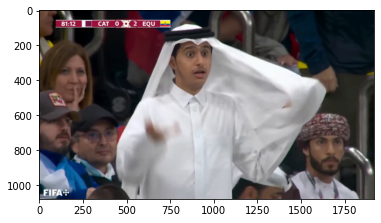

In [24]:
# Mostra o frame do vídeo
plt.imshow(frame_2)

**3 -** Crie uma função que receba **uma imagem como parametro e retorne essa imagem com efeito de cisalhamento**,
utilize os valores **cx = 0.3 e cy = 0.2**.Aplique essa função no frame selecionado na questão anterior e **mostre o resultado**.

faça as alterações necessárias para que a imagem **retornada tenha 3 páginas e não apenas 1**. 

In [25]:
# Função para aplicação do cisalhamento
def cisalhatrom_2000 (frame, cx, cy):

    # Separa algumas características da imagem
    (l, c, p) = np.shape(frame)

    # Prepara um vetor com comprimento e largura proporcionais ao cisalhamento aplicado
    img_shear = np.zeros((int(l * (1.2 + cy)), int(c * (1.2 + cx)), p), dtype=np.uint8)
    
    # Aplica a lógica
    for i in range(l):
        for j in range(c):
            new_x = int(j + cx * i) 
            new_y = int(cy * j + i) 
            img_shear[new_y, new_x, :] = frame[i, j, :] 

    return img_shear

In [26]:
# Aplica o efeito na imagem selecionada
img_cis = cisalhatrom_2000(frame_2, 0.3, 0.2)

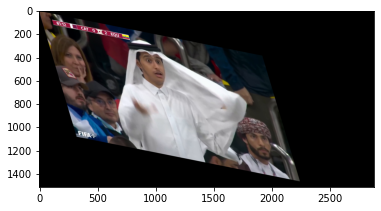

In [27]:
# Mostra o resultado
plt.imshow(img_cis)

**4 -** Crie uma função que receba **uma imagem como parâmetro** e realize a operação de **tintura com a cor RGB(255,36,251)**, e retorne essa imagem com tintura. Aplique essa função no vídeo inteiro e mostre o resultado.

In [28]:
# Função para aplicação da tintura
def pinta_como_eu_pinto(frame):

    # Prepara matriz de 1 canal para aplicação do efeito
    grayscale = np.average(frame, axis=2)

    # Prepara matriz para armezar resultado do efeito 
    tinted = np.zeros(shape=np.shape(frame), dtype=np.uint8)

    # Aplica o efeito em todos os canais
    tinted[:, :, 0] = grayscale * (255 / 255)
    tinted[:, :, 1] = grayscale * ( 36 / 255)
    tinted[:, :, 2] = grayscale * (251 / 255)

    return tinted

In [29]:
# Aplica o efeito de tintura em todo o vídeo
video_tinted = video.fl_image(pinta_como_eu_pinto)

In [30]:
# Mostra o resultado da pintura
video_tinted.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**5 -** Crie uma função que **receba uma imagem como parâmetro** e **retorne sua versão binária**, com **threshold de 100**. Aplique essa função no vídeo inteiro e mostre o resultado.

In [31]:
# Função para limiar binário
def cap_de_100(frame):

    # Separa algumas características da imagem
    (l, c, p) = np.shape(frame)

    # Prepara matriz de 1 canal para uso no efeito
    img_gray = np.average(frame, axis=2)

    # Prepara matrix de 3 canais para armazenar resultado
    bin = np.zeros(shape=(l, c, 3), dtype=np.uint8)

    # Aplica a lógica ( COM THRESHOLD DE 100 )
    for i in range(l):
        for j in range(c):
            if img_gray[i, j] > 100: 
                bin[i, j, :] = 255 
            else: 
                bin[i, j, :] = 0

    return bin

In [32]:
# Aplica o efeito binário em todo o vídeo
video_thres = video.fl_image(cap_de_100)

In [33]:
# Mostra o resultado do efeito binário
video_thres.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**6 -** Particione o vídeo em **subclips e aplique as funções** acima da seguinte forma:
- 0s a 3s: Tintura
- 3s as 5s: Original
- 5s até o final: Imagem binária

**Em seguida junte esses 3 trechos em um único vídeo, exiba o resultado final**.

In [34]:
# Separa os vídeos...
video_pt1 = video.subclip(0, 3) # ... de 0s à 3s
video_pt2 = video.subclip(3, 5) # ... de 3s à 5s
video_pt3 = video.subclip(5)    # ... de 5s até o final

In [35]:
# Aplica os efeitos...
video_pt1_fx = video_pt1.fl_image(pinta_como_eu_pinto)  # ... de Tintura
video_pt2_fx = video_pt2                                # ... nenhum
video_pt3_fx = video_pt3.fl_image(cap_de_100)           # ... de Imagem binária

In [36]:
# Contatena todas as partes em um vídeo
video_final = mpe.concatenate_videoclips([video_pt1_fx, video_pt2_fx, video_pt3_fx])

In [37]:
# Exibe o resultado
video_final.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**7 -** **Salve o vídeo resultante da operação anterior** no disco com o nome "resultado.mp4"

In [38]:
# Salva o vídeo no diretório
video_final.write_videofile("./resultado.mp4")

Moviepy - Building video ./resultado.mp4.
MoviePy - Writing audio in resultadoTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video ./resultado.mp4



Moviepy - Done !
Moviepy - video ready ./resultado.mp4
